In [2]:
import geopandas as gpd
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
import time
from shapely import wkt

In [3]:
def fix_geo(djk_path:list):

    lst = []
    for coor in djk_path:
        _lst_ = [coor]
        lst.append(_lst_)

    lstF = []
    while len(lst) != 0:
        if len(lst) == 1:
            lst.pop()
            break
        lstAux=lst[0]+lst[1]
        lstF.append(lstAux[0]+lstAux[1])
        lst.pop(0)

    _lstF_ = []
    for x in lstF:
        x = x.replace(", ", " ")
        x = x.replace(")(", ", ")
        _lstF_.append(x)

    geo = [["geometry"]]
    for coor in _lstF_:
        coor = "LINESTRING " + coor
        _geo_ = [coor]
        geo.append(_geo_)
    return geo

In [25]:
import csv

def to_csv(geo_length, geo_harassment, geo_average):
    with open("harassment.csv", "w", newline="") as h:
        writer = csv.writer(h)
        writer.writerows(geo_harassment)

    with open("length.csv", "w", newline="") as l:
        writer = csv.writer(l)
        writer.writerows(geo_length)

    with open("average.csv", "w", newline="") as a:
        writer = csv.writer(a)
        writer.writerows(geo_average)


In [5]:
def average(df):
    array = df.values.tolist()

    for arrays in array:
        if arrays[5] == 0:
            arrays.append(arrays[3]/df['length'].max())
        else:
            arrays.append(arrays[3]/df['length'].max()+arrays[5])


    dataframe = pd.DataFrame(array, columns=['name','origin','destination','length','oneway','harassmentRisk','geometry','average'])
    return dataframe

In [30]:
from os import remove
def graph(length_total, harassment_total, total_average, length_harass, harass_harass, average_harass, traversed_length, traversed_harassment, traversed_average):
    route_harassment = pd.read_csv('harassment.csv',sep=';')
    route_harassment['geometry'] = route_harassment['geometry'].apply(wkt.loads)
    route_harassment = gpd.GeoDataFrame(route_harassment)

    route_len = pd.read_csv('length.csv',sep=';')
    route_len['geometry'] = route_len['geometry'].apply(wkt.loads)
    route_len = gpd.GeoDataFrame(route_len)

    route_avr = pd.read_csv('average.csv',sep=';')
    route_avr['geometry'] = route_avr['geometry'].apply(wkt.loads)
    route_avr = gpd.GeoDataFrame(route_avr)


    area = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area['geometry'] = area['geometry'].apply(wkt.loads)
    area = gpd.GeoDataFrame(area)
    
    area1 = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area1['geometry'] = area1['geometry'].apply(wkt.loads)
    area1 = gpd.GeoDataFrame(area1)
    
    area2 = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area2['geometry'] = area2['geometry'].apply(wkt.loads)
    area2 = gpd.GeoDataFrame(area2)

    point_initial = gpd.GeoDataFrame(area1, geometry = gpd.points_from_xy([-75.5826971], [6.1892754]))

    point_final = gpd.GeoDataFrame(area2, geometry = gpd.points_from_xy([-75.5750762], [6.2598846]))

    edges = pd.read_csv('calles_de_medellin.csv',sep=';')
    edges['geometry'] = edges['geometry'].apply(wkt.loads)
    edges = gpd.GeoDataFrame(edges)



    fig, ax = plt.subplots(figsize=(50,50))

    area.plot(ax=ax, facecolor='black', legend=True)
    

    edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

    
    route_harassment.plot(ax=ax, linewidth=1, edgecolor='green')
    route_len.plot(ax=ax, linewidth=1, edgecolor='red')
    route_avr.plot(ax=ax, linewidth=1, edgecolor='purple')


    point_final.plot(ax=ax, color = "orange", legend=True)
    point_initial.plot(ax=ax, color = "brown", legend=True)
    
    plt.title("Rutas calculadas")
    plt.tight_layout()
    plt.savefig("rutas.png")

    
    print("Punto café: INICIAL")
    print("Punto morado: FINAL")
    print("Distancia, acoso  y vertices recorridos camino ROJO: " + length_total + ", " + length_harass + ", " + traversed_length)
    print("Distancia, acoso  y vertices recorridos camino MORADO: " + total_average + ", " + harass_harass + ", " + traversed_harassment)
    print("Distancia, acoso  y vertices recorridos camino VERDE: " + harassment_total + ", " + average_harass + ", " + traversed_average)
    
    remove('harassment.csv')
    remove('length.csv')
    remove('average.csv')

In [31]:
from os import remove
def graph_len(length_total, harassment_length, traversed_length):
    route_len = pd.read_csv('length.csv',sep=';')
    route_len['geometry'] = route_len['geometry'].apply(wkt.loads)
    route_len = gpd.GeoDataFrame(route_len)

    area = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area['geometry'] = area['geometry'].apply(wkt.loads)
    area = gpd.GeoDataFrame(area)
    
    area1 = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area1['geometry'] = area1['geometry'].apply(wkt.loads)
    area1 = gpd.GeoDataFrame(area1)
    
    area2 = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area2['geometry'] = area2['geometry'].apply(wkt.loads)
    area2 = gpd.GeoDataFrame(area2)

    point_initial = gpd.GeoDataFrame(area1, geometry = gpd.points_from_xy([-75.5826971], [6.1892754]))

    point_final = gpd.GeoDataFrame(area2, geometry = gpd.points_from_xy([-75.5750762], [6.2598846]))

    edges = pd.read_csv('calles_de_medellin.csv',sep=';')
    edges['geometry'] = edges['geometry'].apply(wkt.loads)
    edges = gpd.GeoDataFrame(edges)



    fig, ax = plt.subplots(figsize=(50,50))

    area.plot(ax=ax, facecolor='black', legend=True)
    

    edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

    
    route_len.plot(ax=ax, linewidth=1, edgecolor='red')


    point_final.plot(ax=ax, color = "orange", legend=True)
    point_initial.plot(ax=ax, color = "brown", legend=True)
    
    plt.title("Rutas calculadas")
    plt.tight_layout()
    plt.savefig("ruta_corta.png")

    
    print("Punto café: INICIAL")
    print("Punto morado: FINAL")
    print("Distancia, acoso  y vertices recorridos camino ROJO: " + length_total + ", " + harassment_length + ", " + traversed_length)
    
    remove('length.csv')

In [32]:
from os import remove
def graph_harass(harassment_total, harassment_harassment, traversed_harassment):
    route_harassment = pd.read_csv('harassment.csv',sep=';')
    route_harassment['geometry'] = route_harassment['geometry'].apply(wkt.loads)
    route_harassment = gpd.GeoDataFrame(route_harassment)

    area = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area['geometry'] = area['geometry'].apply(wkt.loads)
    area = gpd.GeoDataFrame(area)
    
    area1 = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area1['geometry'] = area1['geometry'].apply(wkt.loads)
    area1 = gpd.GeoDataFrame(area1)
    
    area2 = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area2['geometry'] = area2['geometry'].apply(wkt.loads)
    area2 = gpd.GeoDataFrame(area2)

    point_initial = gpd.GeoDataFrame(area1, geometry = gpd.points_from_xy([-75.5826971], [6.1892754]))

    point_final = gpd.GeoDataFrame(area2, geometry = gpd.points_from_xy([-75.5750762], [6.2598846]))

    edges = pd.read_csv('calles_de_medellin.csv',sep=';')
    edges['geometry'] = edges['geometry'].apply(wkt.loads)
    edges = gpd.GeoDataFrame(edges)



    fig, ax = plt.subplots(figsize=(50,50))

    area.plot(ax=ax, facecolor='black', legend=True)
    

    edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

    
    route_harassment.plot(ax=ax, linewidth=1, edgecolor='green')


    point_final.plot(ax=ax, color = "orange", legend=True)
    point_initial.plot(ax=ax, color = "brown", legend=True)
    
    plt.title("Rutas calculadas")
    plt.tight_layout()
    plt.savefig("ruta_acoso.png")

    
    print("Punto café: INICIAL")
    print("Punto morado: FINAL")
    print("Distancia, acoso  y vertices recorridos camino VERDE: " + harassment_total + ", " + harassment_harassment + ", " + traversed_harassment)
    
    remove('harassment.csv')
    

In [33]:
from os import remove
def graph_avr(total_average, average_harassment, traversed_average):
    
    route_avr = pd.read_csv('average.csv',sep=';')
    route_avr['geometry'] = route_avr['geometry'].apply(wkt.loads)
    route_avr = gpd.GeoDataFrame(route_avr)


    area = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area['geometry'] = area['geometry'].apply(wkt.loads)
    area = gpd.GeoDataFrame(area)
    
    area1 = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area1['geometry'] = area1['geometry'].apply(wkt.loads)
    area1 = gpd.GeoDataFrame(area1)
    
    area2 = pd.read_csv('poligono_de_medellin.csv',sep=';')
    area2['geometry'] = area2['geometry'].apply(wkt.loads)
    area2 = gpd.GeoDataFrame(area2)

    point_initial = gpd.GeoDataFrame(area1, geometry = gpd.points_from_xy([-75.5826971], [6.1892754]))

    point_final = gpd.GeoDataFrame(area2, geometry = gpd.points_from_xy([-75.5750762], [6.2598846]))

    edges = pd.read_csv('calles_de_medellin.csv',sep=';')
    edges['geometry'] = edges['geometry'].apply(wkt.loads)
    edges = gpd.GeoDataFrame(edges)



    fig, ax = plt.subplots(figsize=(50,50))

    area.plot(ax=ax, facecolor='black', legend=True)
    

    edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

    route_avr.plot(ax=ax, linewidth=1, edgecolor='purple')


    point_final.plot(ax=ax, color = "orange", legend=True)
    point_initial.plot(ax=ax, color = "brown", legend=True)
    
    plt.title("Rutas calculadas")
    plt.tight_layout()
    plt.savefig("rutas.png")

    
    print("Punto café: INICIAL")
    print("Punto morado: FINAL")
    print("Distancia, acoso  y vertices recorridos camino MORADO: " + total_average + ", " + average_harassment + ", " + traversed_average)
    
    remove('harassment.csv')
    remove('length.csv')
    remove('average.csv')
    

In [34]:
def find_length(path, df):
    pathAUX=path
    origins=[]
    destinations=[]
    total_length=0
    origins.append(pathAUX.pop(0))
    while len(path)!=0:
        if len(path) == 1:
            destinations.append(path.pop(0))
        else:
            i=path.pop(0)
            origins.append(i)
            destinations.append(i)
          
    for i in range(len(origins)): 
        df_length=df[(df.origin == origins[i]) & (df.destination == destinations[i])]
        length_object=df_length['length']
        lst=list(length_object)
        if not lst:
            df_lengthAUX=df[(df.origin == destinations[i]) & (df.destination == origins[i])]
            length_objectAUX=df_lengthAUX['length']
            lstAUX=list(length_objectAUX)
            total_length+=lstAUX[0]
        else:
            total_length+=lst[0]
        
    return total_length
            

def find_harassment(path, df):
    origins=[]
    destinations=[]
    total_harass=0
    origins.append(path.pop(0))
    while len(path)!=0:
        if len(path) == 1:
            destinations.append(path.pop(0))
        else:
            i=path.pop(0)
            origins.append(i)
            destinations.append(i)
            
    for i in range(len(origins)): 
        df_harass=df[(df.origin == origins[i]) & (df.destination == destinations[i])]
        harass_object=df_harass['harassmentRisk']
        lst=list(harass_object)
        if not lst:
            df_harassAUX=df[(df.origin == destinations[i]) & (df.destination == origins[i])]
            harass_objectAUX=df_harassAUX['harassmentRisk']
            lstAUX=list(harass_objectAUX)
            total_harass+=lstAUX[0]
        else:
            total_harass+=lst[0]
        
    return total_harass/len(origins)


      
        
def printAverage(source,target):
    start_time = time.time()



    df = pd.read_csv("calles_de_medellin.csv",sep=';')
    df = df.fillna(0)


    
    streets_length = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="length")
    djk_path_length = nx.dijkstra_path(streets_length, source=source, target=target, weight="length")
    traversed_length = len(djk_path_length)
    geo_length = fix_geo(djk_path_length)
    length_total = find_length(djk_path_length, df)
    djk_path_length = nx.dijkstra_path(streets_length, source=source, target=target, weight="length")
    length_harassment=find_harassment(djk_path_length, df)

    streets_harassment = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="harassmentRisk")
    djk_path_harassment = nx.dijkstra_path(streets_harassment, source=source, target=target, weight="harassmentRisk")
    traversed_harassment = len(djk_path_harassment)
    geo_harassment = fix_geo(djk_path_harassment)
    harassment_total = find_length(djk_path_harassment, df)
    djk_path_harassment = nx.dijkstra_path(streets_harassment, source=source, target=target, weight="harassmentRisk")
    harassment_harassment = find_harassment(djk_path_harassment, df)

    df = average(df)
    streets_avr = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="average")
    djk_path_average = nx.dijkstra_path(streets_avr, source=source, target=target, weight="average")
    traversed_average = len(djk_path_average)
    geo_average = fix_geo(djk_path_average)
    total_average = find_length(djk_path_average, df)
    djk_path_average = nx.dijkstra_path(streets_avr, source=source, target=target, weight="average")
    average_harassment = find_harassment(djk_path_average, df)

    to_csv(geo_length, geo_harassment, geo_average)

    graph_avr(str(total_average), str(harassment_harassment), str(traversed_harassment))

    print("--- %s seconds ---" % (time.time() - start_time))
    
def printLength(source,target):
    start_time = time.time()



    df = pd.read_csv("calles_de_medellin.csv",sep=';')
    df = df.fillna(0)


    streets_length = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="length")
    djk_path_length = nx.dijkstra_path(streets_length, source=source, target=target, weight="length")
    traversed_length = len(djk_path_length)
    geo_length = fix_geo(djk_path_length)
    length_total = find_length(djk_path_length, df)
    djk_path_length = nx.dijkstra_path(streets_length, source=source, target=target, weight="length")
    length_harassment=find_harassment(djk_path_length, df)



    streets_harassment = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="harassmentRisk")
    djk_path_harassment = nx.dijkstra_path(streets_harassment, source=source, target=target, weight="harassmentRisk")
    traversed_harassment = len(djk_path_harassment)
    geo_harassment = fix_geo(djk_path_harassment)
    harassment_total = find_length(djk_path_harassment, df)
    djk_path_harassment = nx.dijkstra_path(streets_harassment, source=source, target=target, weight="harassmentRisk")
    harassment_harassment = find_harassment(djk_path_harassment, df)

    df = average(df)
    streets_avr = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="average")
    djk_path_average = nx.dijkstra_path(streets_avr, source=source, target=target, weight="average")
    traversed_average = len(djk_path_average)
    geo_average = fix_geo(djk_path_average)
    total_average = find_length(djk_path_average, df)
    djk_path_average = nx.dijkstra_path(streets_avr, source=source, target=target, weight="average")
    average_harassment = find_harassment(djk_path_average, df)

    to_csv(geo_length, geo_harassment, geo_average)


    graph_len(str(length_total), str(length_harassment), str(traversed_length))

    print("--- %s seconds ---" % (time.time() - start_time))
    
def printHarassmentRisk(source,target):
    start_time = time.time()



    df = pd.read_csv("calles_de_medellin.csv",sep=';')
    df = df.fillna(0)

    streets_length = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="length")
    djk_path_length = nx.dijkstra_path(streets_length, source=source, target=target, weight="length")
    traversed_length = len(djk_path_length)
    geo_length = fix_geo(djk_path_length)
    length_total = find_length(djk_path_length, df)
    djk_path_length = nx.dijkstra_path(streets_length, source=source, target=target, weight="length")
    length_harassment=find_harassment(djk_path_length, df)



    streets_harassment = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="harassmentRisk")
    djk_path_harassment = nx.dijkstra_path(streets_harassment, source=source, target=target, weight="harassmentRisk")
    traversed_harassment = len(djk_path_harassment)
    geo_harassment = fix_geo(djk_path_harassment)
    harassment_total = find_length(djk_path_harassment, df)
    djk_path_harassment = nx.dijkstra_path(streets_harassment, source=source, target=target, weight="harassmentRisk")
    harassment_harassment = find_harassment(djk_path_harassment, df)

    df = average(df)
    streets_avr = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="average")
    djk_path_average = nx.dijkstra_path(streets_avr, source=source, target=target, weight="average")
    traversed_average = len(djk_path_average)
    geo_average = fix_geo(djk_path_average)
    total_average = find_length(djk_path_average, df)
    djk_path_average = nx.dijkstra_path(streets_avr, source=source, target=target, weight="average")
    average_harassment = find_harassment(djk_path_average, df)

    to_csv(geo_length, geo_harassment, geo_average)


    graph_harass(str(harassment_total), str(average_harassment), str(traversed_average))

    print("--- %s seconds ---" % (time.time() - start_time))




    
def printPaths(source,target):
    
    start_time = time.time()



    df = pd.read_csv("calles_de_medellin.csv",sep=';')
    df = df.fillna(0)


    streets_length = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="length")
    djk_path_length = nx.dijkstra_path(streets_length, source=source, target=target, weight="length")
    traversed_length = len(djk_path_length)
    geo_length = fix_geo(djk_path_length)
    length_total = find_length(djk_path_length, df)
    djk_path_length = nx.dijkstra_path(streets_length, source=source, target=target, weight="length")
    length_harassment=find_harassment(djk_path_length, df)



    streets_harassment = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="harassmentRisk")
    djk_path_harassment = nx.dijkstra_path(streets_harassment, source=source, target=target, weight="harassmentRisk")
    traversed_harassment = len(djk_path_harassment)
    geo_harassment = fix_geo(djk_path_harassment)
    harassment_total = find_length(djk_path_harassment, df)
    djk_path_harassment = nx.dijkstra_path(streets_harassment, source=source, target=target, weight="harassmentRisk")
    harassment_harassment = find_harassment(djk_path_harassment, df)

    df = average(df)
    streets_avr = nx.from_pandas_edgelist(df,source="origin", target="destination", edge_attr="average")
    djk_path_average = nx.dijkstra_path(streets_avr, source=source, target=target, weight="average")
    traversed_average = len(djk_path_average)
    geo_average = fix_geo(djk_path_average)
    total_average = find_length(djk_path_average, df)
    djk_path_average = nx.dijkstra_path(streets_avr, source=source, target=target, weight="average")
    average_harassment = find_harassment(djk_path_average, df)

    to_csv(geo_length, geo_harassment, geo_average)

    graph(str(length_total), str(harassment_total), str(total_average), str(length_harassment), str(harassment_harassment), str(average_harassment), str(traversed_length), str(traversed_harassment), str(traversed_average))

    print("--- %s seconds ---" % (time.time() - start_time))


Punto café: INICIAL
Punto morado: FINAL
Distancia, acoso  y vertices recorridos camino ROJO: 8271.732, 0.3426656395998138, 44
Distancia, acoso  y vertices recorridos camino MORADO: 10774.136000000002, 0.18446993757461858, 38
Distancia, acoso  y vertices recorridos camino VERDE: 11094.122000000003, 0.17961546553318125, 39
--- 47.825417280197144 seconds ---


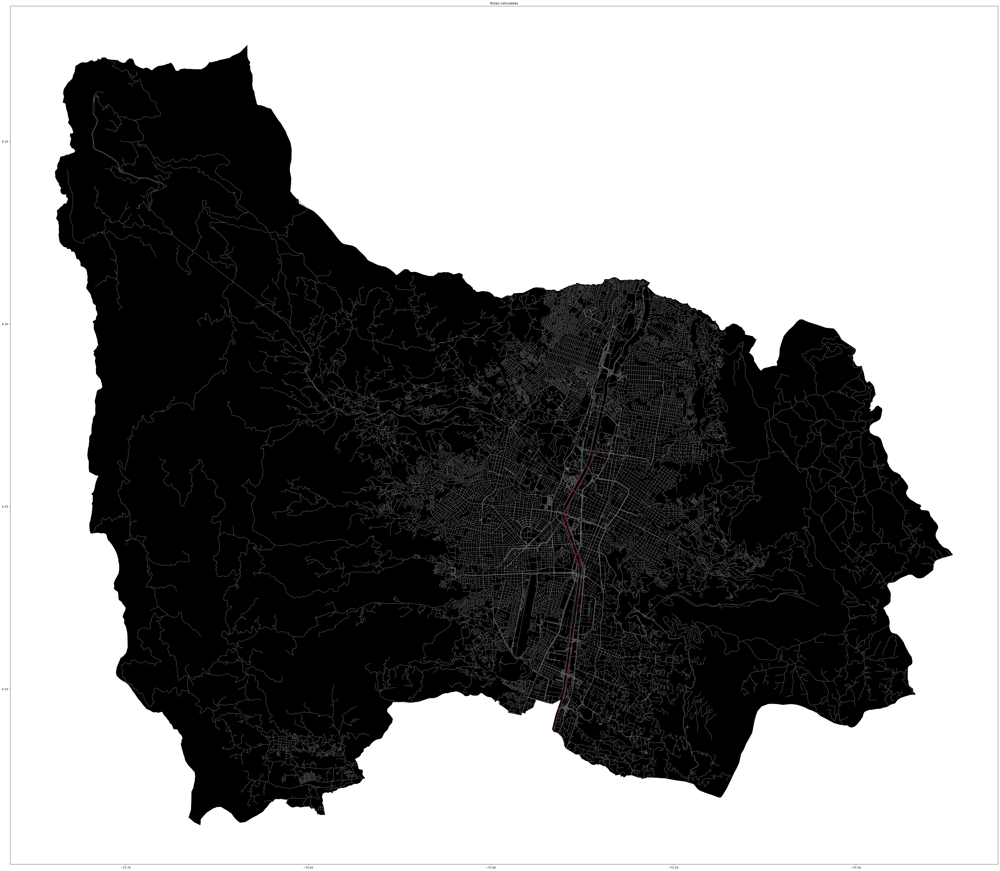

In [12]:
printPaths('(-75.5826971, 6.1892754)','(-75.5750762, 6.2598846)')





Punto café: INICIAL
Punto morado: FINAL
Distancia, acoso  y vertices recorridos camino ROJO: 8271.732, 0.3426656395998138, 44
--- 48.43116044998169 seconds ---


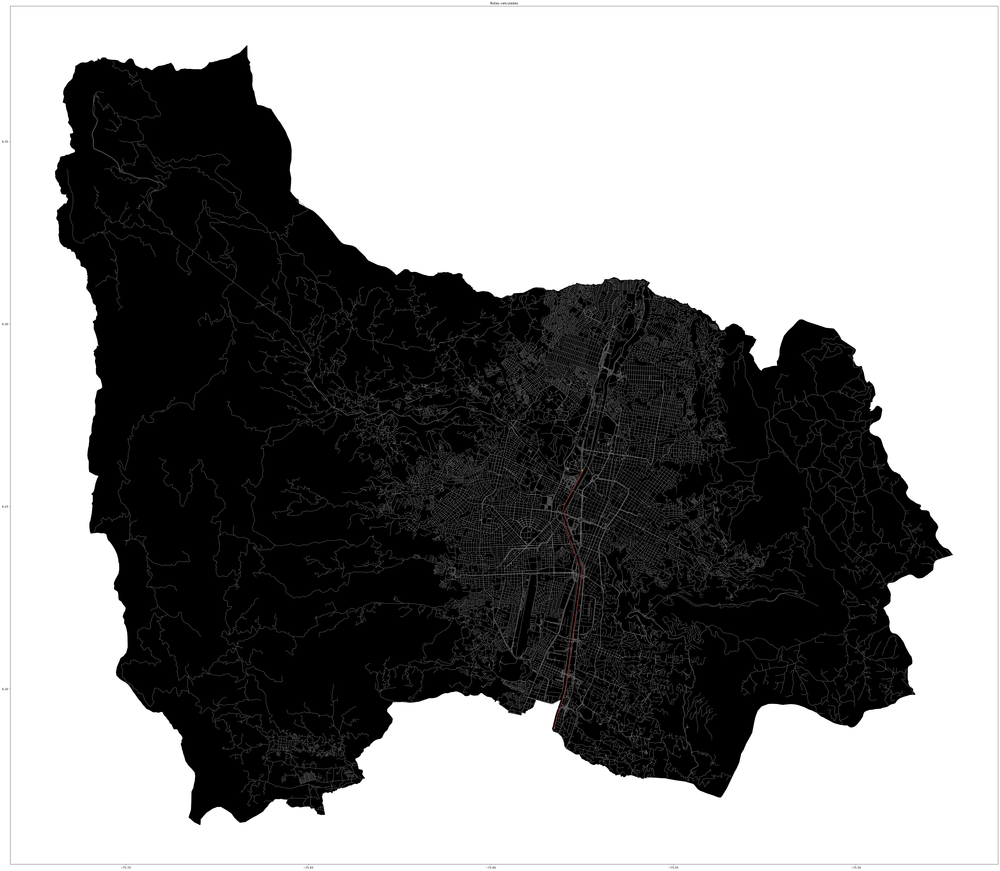

In [35]:
printLength('(-75.5826971, 6.1892754)','(-75.5750762, 6.2598846)')

Punto café: INICIAL
Punto morado: FINAL
Distancia, acoso  y vertices recorridos camino VERDE: 11094.122000000003, 0.17961546553318125, 39
--- 47.329102516174316 seconds ---


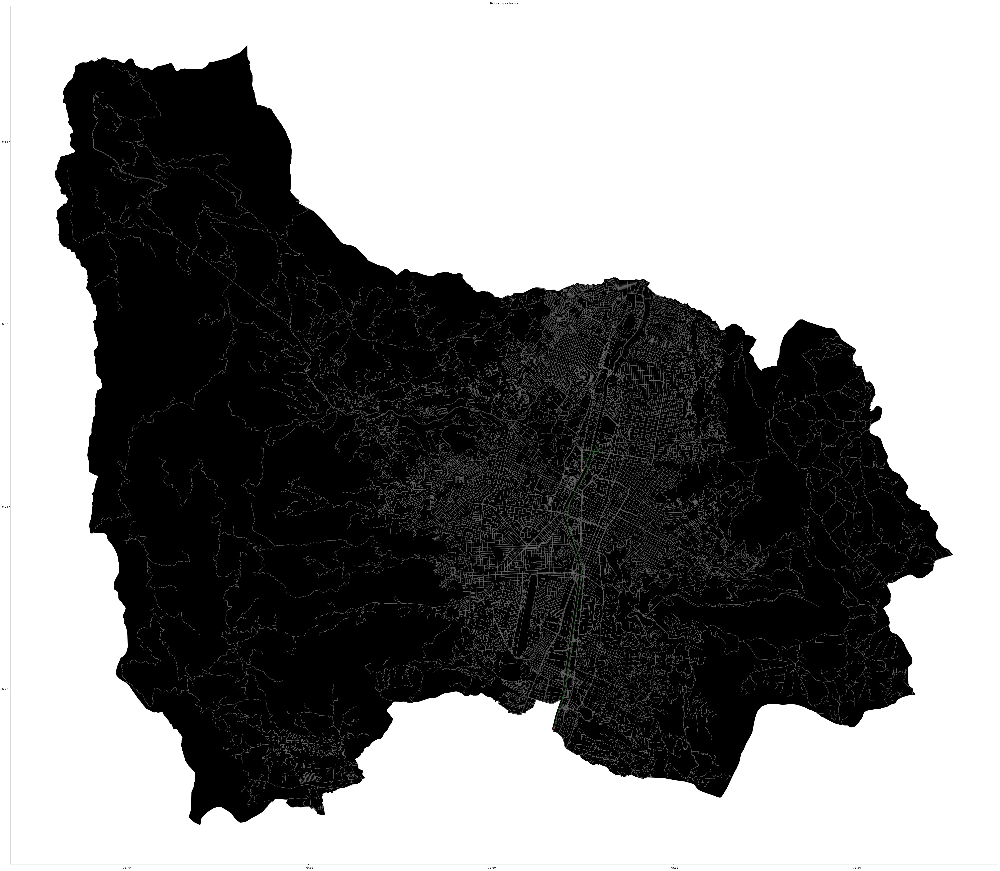

In [29]:
printHarassmentRisk('(-75.5826971, 6.1892754)','(-75.5750762, 6.2598846)')

Punto café: INICIAL
Punto morado: FINAL
Distancia, acoso  y vertices recorridos camino MORADO: 10774.136000000002, 0.18446993757461858, 38
--- 48.064085245132446 seconds ---


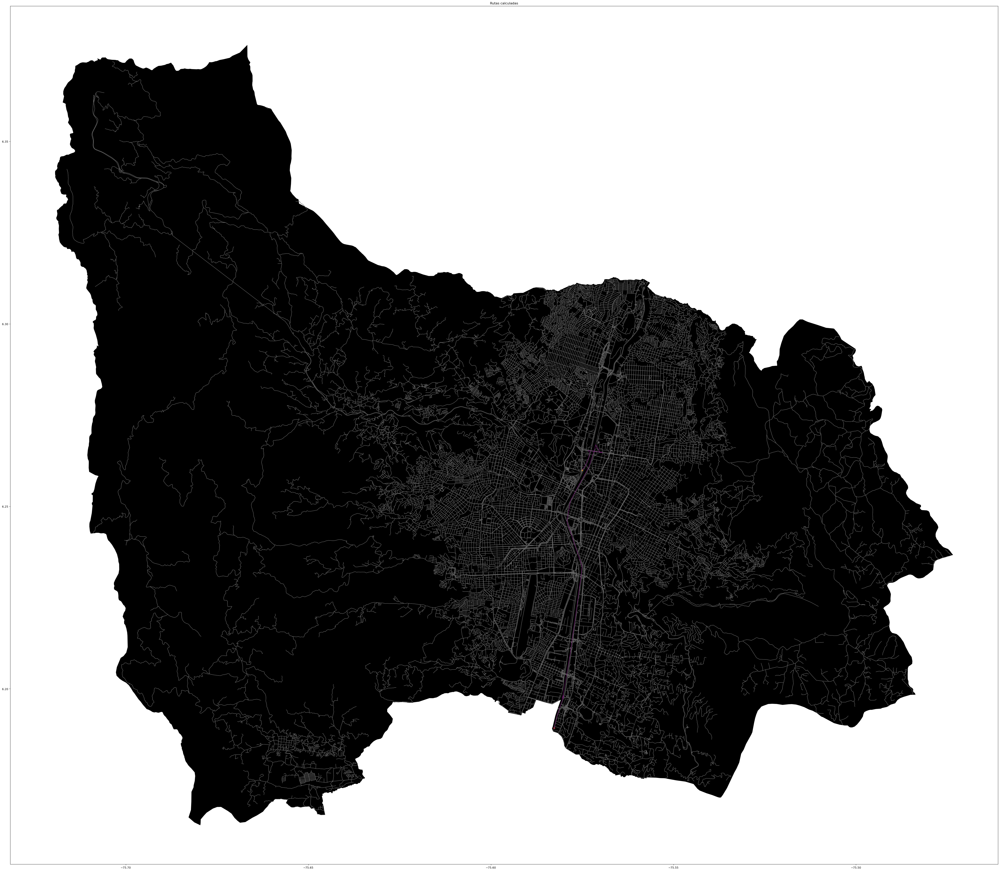

In [36]:
printAverage('(-75.5826971, 6.1892754)','(-75.5750762, 6.2598846)')
